<a href="https://colab.research.google.com/github/AlvaroArroyo/RFormer/blob/main/Cross_sectional_research.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# 1. Setting-up the Notebook

In [22]:
#Monitor of Resources
from urllib.request import urlopen
exec(urlopen("http://colab-monitor.smankusors.com/track.py").read())
_colabMonitor = ColabMonitor().start()
#_colabMonitor = ColabMonitor(tpu=tpu).start() #TPU

Now live at : http://colab-monitor.smankusors.com/67dea98be487b


In [23]:
import os
from google.colab import drive
data_path = '/content/drive/MyDrive/Shared_Data/'
#data_path = '/content/drive/MyDrive/Z_Research/Shared_Data/'

import sys
sys.path.append("/content/drive/MyDrive/Shared_Notebooks")
#sys.path.append("/content/drive/MyDrive/Z_Research/Shared_Notebooks")
import pandas as pd
import numpy as np

import numpy as np
import pandas as pd
from sklearn.linear_model import LinearRegression, Ridge
from scipy.stats import spearmanr, pearsonr

import torch

import matplotlib.pyplot as plt
import seaborn as sns

In [24]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [25]:
#How to create a venv in GDrive, activate it, and install packages
#!pip install virtualenv
#!virtualenv /content/drive/MyDrive/vir_env_zresearch
#!source /content/drive/MyDrive/vir_env_zresearch/bin/activate; pip install ipdb

In [26]:
#If using the virtual env 'vir_env_zresearch', just activate it to add packages (see how to create a venv in GDrive in previous cell)
sys.path.append("/content/drive/MyDrive/vir_env_zresearch/lib/python3.10/site-packages")
#Otherwise, just uncomment next lines and install packages manually:
#!pip install ipdb
#import ipdb

In [27]:
#%pdb on #For debugging purposes, can be commented
import zstandard as zstd
import pickle

# 2. Data Loading and Preprocessing


## 2.1. Loading data and creating dataframe of (T, Markets)

In [28]:
# Let's load the 1 minute daya for the front contracts from a pickled pandas dataframe

with open(os.path.join(data_path,"frontcontracts.zst"), "rb") as f:
    decompressor = zstd.ZstdDecompressor()
    df_loaded = pickle.loads(decompressor.decompress(f.read()))

In [29]:
# Let's have a look at the data:
# NOTE: All prices (open, high, low, close) are cast as integers, the actual price is 1e-9 times the integer,
# i.e. 3237750000000 is 3237.75

df_loaded.head()

,ts_event,rtype,publisher_id,instrument_id,open,high,low,close,volume,symbol,date,derived_symbol
76,2020-01-02 00:00:00,33,1,10571,3237750000000,3238250000000,3237500000000,3237500000000,285,ESH0,2020-01-02,ES.v.0
77,2020-01-02 00:01:00,33,1,10571,3237500000000,3238000000000,3237500000000,3238000000000,97,ESH0,2020-01-02,ES.v.0
78,2020-01-02 00:02:00,33,1,10571,3238000000000,3238250000000,3238000000000,3238250000000,66,ESH0,2020-01-02,ES.v.0
80,2020-01-02 00:03:00,33,1,10571,3238000000000,3238250000000,3237500000000,3237750000000,358,ESH0,2020-01-02,ES.v.0
81,2020-01-02 00:04:00,33,1,10571,3237500000000,3237750000000,3237250000000,3237250000000,199,ESH0,2020-01-02,ES.v.0


In [30]:
# Here are all the markets available:

markets = ['ES','NQ','RTY', 'YM',         # Equity Index Futures          06:30-16:30
           #'NIY',                         # Foreign Equity Index Futures  ++++++ Exclude for now
           'BTC','ETH',                   # Crypto Futures                01:00-23:00
           '6A','6B','6C','6E','6J','6S', # FX Futures
           #'6M','6L',                     # EM FX Futures                 ++++++ Exclude for now
           'GC','PL','HG','SI','PA' ,     # Metal Futures
           'CL','RB','NG',                # Energy Futures
           'ZN','ZF','ZB', 'UB',          # Interest Rate Futures
           #'ZS','ZW','ZL','ZC'            # Agricultural Futures          ++++++ Exclude for now
           ]

# ES (E-mini S&P 500 Futures),  NQ (E-mini Nasdaq-100 Futures), RTY (E-mini Russell 2000 Index Futures), YM (Dow Jones Futures)

# BTC (Bitcoin Futures), ETH (Ether Futures)

# 6A (Australian Dollar Futures), 6B (British Pound Futures), 6C (Canadian Dollar Futures),
# 6E (Euro FX Futures), 6J (Japanese Yen Futures),6S (Swiss Franc Futures)

# 6M (Mexican Peso Futures), 6L (Brazilian Real Futures)

# GC (Gold Futures), PL (Platinum Futures), HG (Copper Futures), 'SI' (Silver Futures) and 'PA' (Palladium Futures):

# CL (Crude Oil Futures), RB (RBOB Gasoline Futures), NG (Henry Hub Natural Gas Futures)

# ZN (10-Year T-Note Futures), ZF (5-Year T-Note Futures), ZB (U.S. Treasury Bond Futures), 'UB' (Ultra T-Bond Futures)

# ZS (Soybean Futures), ZW (Chicago SRW Wheat Futures),ZL (Soybean Oil Futures), ZC (Corn Futures)


In [31]:
import pandas as pd
import numpy as np

def create_rolled_dataframe(df_loaded,
                            markets=markets,
                            freq='10min',
                            columns=['ts_event','open','symbol','derived_symbol']):
    """
    Create a wide DataFrame of rolled open prices for the specified markets.

    The function performs the following steps for each unique derived symbol in the raw data:
      1. Checks if the base market (extracted from the derived_symbol) is in the provided markets list.
      2. Subsets the data for that derived symbol using the specified columns.
      3. Converts the timestamp column to a timezone-aware datetime (UTC then converted to US/Eastern) and sorts the data.
      4. Computes the difference between consecutive open prices.
      5. Zeros out differences when the underlying contract changes (i.e. when 'symbol' changes).
      6. Reconstructs a continuous ("rolled") price series by cumulative summing the differences and adjusting the series
         so that the final rolled price equals the final open price.
      7. Downsamples the continuous series to the specified frequency.
      8. Aggregates the downsampled series for each market into a wide DataFrame and forward fills missing values.

    Parameters:
      df_loaded (pd.DataFrame): The raw input DataFrame.
      markets (list): List of base market symbols to include. Default provided in the example.
      freq (str): Frequency for downsampling (e.g., '10min'). Default is '10min'.
      columns (list): List of columns to subset from df_loaded. Default is ['ts_event','open','symbol','derived_symbol'].

    Returns:
      pd.DataFrame: A wide DataFrame with a DateTime index and one column per market containing the rolled prices.
    """

    df_dict = {}

    # Loop over each unique derived symbol in the data
    for derived in df_loaded['derived_symbol'].unique():
        # Extract the base market symbol from the derived_symbol (e.g., 'ES' from 'ES.v.0')
        base_market = derived.split('.')[0]
        if base_market not in markets:
            continue  # Skip if the market is not in the list

        # Filter the data for the current derived symbol and select the specified columns
        data = df_loaded[df_loaded['derived_symbol'] == derived][columns].copy()

        # Convert the timestamp column to datetime (in UTC), set as index, convert to US/Eastern, and sort
        data['ts_event'] = pd.to_datetime(data['ts_event'], utc=True)
        data = data.set_index('ts_event')
        data.index = data.index.tz_convert('US/Eastern')
        data = data.sort_index()

        # Compute the difference in open prices between consecutive rows
        diffs = data['open'].diff().fillna(0.0)

        # When the contract changes (i.e. 'symbol' changes), zero out the price difference
        contract_changes = data['symbol'].shift() != data['symbol']
        diffs[contract_changes] = 0

        # Reconstruct the continuous (rolled) price series using cumulative sum of differences
        rolled_prices = diffs.cumsum()
        # Adjust the series so that the last value matches the actual last open price
        data['rolled_prices'] = rolled_prices + data['open'].iloc[-1] - rolled_prices.iloc[-1]

        # Downsample the rolled price series to the desired frequency using the first value in each interval
        df_dict[base_market] = data['rolled_prices'].resample(freq).first()

    # Combine the individual series into a single DataFrame and forward-fill missing values
    df = pd.DataFrame(df_dict)
    df = df.ffill()

    return df

# Example usage:
# df_rolled = create_rolled_dataframe(df_loaded)
# print(df_rolled.head())

In [32]:
df = create_rolled_dataframe(df_loaded)

In [33]:
df.head()

,ES,NQ,RTY,YM,BTC,ETH,6A,6B,6C,6E,...,HG,SI,PA,CL,RB,NG,ZN,ZF,ZB,UB
ts_event,,,,,,,,,,,,,,,,,,,,,
2020-01-01 19:00:00-05:00,3.378500e+12,9.659250e+12,1.732100e+12,2.911700e+13,2.204500e+13,NaN,721750000.0,1.339400e+09,777100000.0,1.212550e+09,...,2.811000e+09,1.978500e+10,1.701300e+12,5.725000e+10,416200000.0,6.476000e+09,1.257500e+11,1.191406e+11,1.485625e+11,1.786250e+11
2020-01-01 19:10:00-05:00,3.378250e+12,9.659000e+12,1.732000e+12,2.911600e+13,2.203500e+13,NaN,721750000.0,1.339600e+09,777100000.0,1.212450e+09,...,2.810000e+09,1.979500e+10,1.700700e+12,5.722000e+10,415900000.0,6.477000e+09,1.257656e+11,1.191562e+11,1.485938e+11,1.787188e+11
2020-01-01 19:20:00-05:00,3.378500e+12,9.660000e+12,1.732100e+12,2.912200e+13,2.203500e+13,NaN,721650000.0,1.339400e+09,777000000.0,1.212250e+09,...,2.809500e+09,1.979000e+10,1.700900e+12,5.726000e+10,416400000.0,6.477000e+09,1.257656e+11,1.191562e+11,1.485938e+11,1.787188e+11
2020-01-01 19:30:00-05:00,3.378750e+12,9.660750e+12,1.732400e+12,2.912200e+13,2.204000e+13,NaN,721450000.0,1.339500e+09,777000000.0,1.212300e+09,...,2.809500e+09,1.978500e+10,1.700900e+12,5.727000e+10,416300000.0,6.478000e+09,1.257656e+11,1.191719e+11,1.486250e+11,1.787188e+11
2020-01-01 19:40:00-05:00,3.379250e+12,9.662000e+12,1.732700e+12,2.912600e+13,2.204000e+13,NaN,721350000.0,1.339700e+09,777000000.0,1.212200e+09,...,2.810500e+09,1.978000e+10,1.700900e+12,5.728000e+10,414700000.0,6.479000e+09,1.257656e+11,1.191719e+11,1.485938e+11,1.787500e+11


In [34]:
df.tail()

,ES,NQ,RTY,YM,BTC,ETH,6A,6B,6C,6E,...,HG,SI,PA,CL,RB,NG,ZN,ZF,ZB,UB
ts_event,,,,,,,,,,,,,,,,,,,,,
2023-12-29 16:10:00-05:00,4.814250e+12,1.701400e+13,2.045200e+12,3.797200e+13,4.271000e+13,2.350000e+12,682800000.0,1.274400e+09,755500000.0,1.107050e+09,...,3.891000e+09,2.402000e+10,1.103500e+12,7.135000e+10,2.107600e+09,2.503000e+09,1.126875e+11,1.086641e+11,1.245000e+11,1.330938e+11
2023-12-29 16:20:00-05:00,4.813500e+12,1.700675e+13,2.042800e+12,3.796500e+13,4.271000e+13,2.350000e+12,682850000.0,1.274300e+09,755550000.0,1.106900e+09,...,3.891500e+09,2.402000e+10,1.103000e+12,7.129000e+10,2.107700e+09,2.503000e+09,1.126875e+11,1.086641e+11,1.245312e+11,1.330938e+11
2023-12-29 16:30:00-05:00,4.814000e+12,1.700825e+13,2.044300e+12,3.797200e+13,4.271000e+13,2.350000e+12,682950000.0,1.274400e+09,755350000.0,1.107100e+09,...,3.892000e+09,2.402500e+10,1.101500e+12,7.126000e+10,2.107000e+09,2.499000e+09,1.126875e+11,1.086641e+11,1.245312e+11,1.331250e+11
2023-12-29 16:40:00-05:00,4.814250e+12,1.700850e+13,2.044900e+12,3.796600e+13,4.271000e+13,2.350000e+12,682800000.0,1.274500e+09,755450000.0,1.107250e+09,...,3.891500e+09,2.402500e+10,1.103500e+12,7.128000e+10,2.107800e+09,2.497000e+09,1.126719e+11,1.086562e+11,1.244688e+11,1.330938e+11
2023-12-29 16:50:00-05:00,4.814250e+12,1.700900e+13,2.045500e+12,3.797100e+13,4.271000e+13,2.350000e+12,682700000.0,1.274200e+09,755500000.0,1.107250e+09,...,3.892000e+09,2.402500e+10,1.106000e+12,7.136000e+10,2.115400e+09,2.498000e+09,1.127031e+11,1.086719e+11,1.245000e+11,1.330625e+11


## 2.2. Analysing the dataset

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.stats.stattools import jarque_bera
from scipy.stats import shapiro
import math

def describe_data(df):
    """
    Print basic information about the DataFrame:
      - Shape
      - Column data types
      - Missing values
      - Descriptive statistics for numeric columns
    """
    print("=== DataFrame Shape ===")
    print(df.shape)
    print("\n=== Column Info ===")
    print(df.info())

    print("\n=== Missing Values ===")
    print(df.isnull().sum())

    print("\n=== Descriptive Statistics (Numeric Columns) ===")
    print(df.describe(include=[np.number]))

def get_numeric_columns(df):
    """
    Return a list of numeric column names.
    """
    return df.select_dtypes(include=[np.number]).columns.tolist()

# Example usage:
# numeric_cols = get_numeric_columns(df)
# print("Numeric Columns:", numeric_cols)


def correlation_matrix(df):
    """
    Compute the correlation matrix for numeric columns in the DataFrame.
    Returns a pandas DataFrame containing correlations.
    """
    numeric_cols = get_numeric_columns(df)
    corr = df[numeric_cols].corr()
    return corr

# Example usage:
# corr = correlation_matrix(df)
# print(corr)

def plot_correlation_heatmap(df, figsize=None, cmap='coolwarm', annot=True, annot_fontsize=8, rotation=45):
    """
    Plot a heatmap of the correlation matrix for numeric columns with configurable options
    to handle overlapping text when there are many columns.

    Parameters:
        df (pd.DataFrame): The input DataFrame.
        figsize (tuple): Figure size (width, height). If None, it's determined automatically.
        cmap (str): Colormap for the heatmap. Defaults to 'coolwarm'.
        annot (bool): Whether to display correlation values in each cell. Defaults to True.
        annot_fontsize (int): Font size for the annotation text. Defaults to 8.
        rotation (int): Rotation for the x-axis tick labels. Defaults to 45.
    """
    numeric_cols = get_numeric_columns(df)
    corr = df[numeric_cols].corr()

    # Auto-resize the figure if not provided
    if figsize is None:
        n_cols = len(corr.columns)
        # Scale figure size based on number of columns (tweak these multipliers as needed)
        figsize = (max(8, n_cols * 0.6), max(6, n_cols * 0.5))

    plt.figure(figsize=figsize)
    sns.heatmap(
        corr,
        annot=annot,
        fmt=".2f",
        cmap=cmap,
        # If you want square cells, set square=True, but that often makes large matrices hard to read
        square=False,
        vmin=-1,
        vmax=1,
        annot_kws={"size": annot_fontsize}
    )

    # Rotate x-axis labels to avoid overlap
    plt.xticks(rotation=rotation, ha='right')
    plt.yticks(rotation=0)  # Keep y-axis labels horizontal

    plt.title("Correlation Heatmap")
    plt.tight_layout()  # Helps reduce overlap
    plt.show()

def plot_histograms(df, bins=30, figsize=(12, 8)):
    """
    Plot histograms for all numeric columns in the DataFrame.
    """
    numeric_cols = get_numeric_columns(df)
    df[numeric_cols].hist(bins=bins, figsize=figsize)
    plt.tight_layout()
    plt.show()

# Example usage:
# plot_histograms(df)


def plot_boxplots(df, figsize=(12, 8)):
    """
    Plot boxplots for all numeric columns in the DataFrame arranged in a grid.

    Each numeric column (for example, each symbol in your wide DataFrame)
    will be shown in its own subplot. The grid layout is computed automatically.
    """
    numeric_cols = get_numeric_columns(df)
    num_plots = len(numeric_cols)

    # Determine grid size: aim for a nearly square layout
    ncols = int(np.ceil(np.sqrt(num_plots)))
    nrows = int(np.ceil(num_plots / ncols))

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize)

    # Flatten axes for easy iteration (even if it's just one row/column)
    if num_plots == 1:
        axes = [axes]
    else:
        axes = axes.flatten()

    # Plot a boxplot for each numeric column
    for i, col in enumerate(numeric_cols):
        sns.boxplot(data=df, y=col, ax=axes[i])
        axes[i].set_title(col)

    # Remove any extra subplots if the grid has more spaces than columns
    for j in range(i + 1, len(axes)):
        fig.delaxes(axes[j])

    plt.tight_layout()
    plt.show()

# Example usage:
# plot_boxplots(df)

def detect_outliers_iqr(df, multiplier=1.5):
    """
    Detect outliers in numeric columns using the IQR method.
    Returns a dictionary where each key is a column name,
    and the value is the index of outlier rows for that column.
    """
    numeric_cols = get_numeric_columns(df)
    outliers = {}

    for col in numeric_cols:
        Q1 = df[col].quantile(0.25)
        Q3 = df[col].quantile(0.75)
        IQR = Q3 - Q1
        lower_bound = Q1 - multiplier * IQR
        upper_bound = Q3 + multiplier * IQR

        outlier_indices = df[(df[col] < lower_bound) | (df[col] > upper_bound)].index
        outliers[col] = outlier_indices

    return outliers

# Example usage:
# outliers = detect_outliers_iqr(df)
# print(outliers)

def plot_pairwise_relationships(df, hue=None):
    """
    Plot pairwise relationships (scatter plots, histograms on the diagonal)
    using Seaborn's pairplot for numeric columns.
    Optionally use a 'hue' column to color the data points.
    """
    numeric_cols = get_numeric_columns(df)
    sns.pairplot(df[numeric_cols + [hue]] if hue else df[numeric_cols],
                 hue=hue, diag_kind="kde")
    plt.show()

# Example usage:
# plot_pairwise_relationships(df, hue='symbol')

def plot_time_series_subplots(df, title='Time Series Plots by Market',
                              nrows=None, ncols=2, figsize=None,
                              sharex=True, sharey=False):
    """
    Plot each column in a separate subplot arranged in a grid (in a single figure).
    Assumes df has a DatetimeIndex.

    Parameters:
      df (pd.DataFrame): The wide DataFrame with a time index and one column per market.
      title (str): Overall title for the figure.
      nrows (int): Number of rows in the subplot grid. If None, computed as ceil(num_columns / ncols).
      ncols (int): Number of columns in the subplot grid. Default is 2.
      figsize (tuple): Figure size. If None, computed as (ncols*5, nrows*3).
      sharex (bool): Whether subplots share the same x-axis. Default is True.
      sharey (bool): Whether subplots share the same y-axis. Default is False.

    This function creates a single figure with all subplots arranged in a grid.
    """
    num_plots = len(df.columns)

    # Compute nrows if not provided.
    if nrows is None:
        nrows = math.ceil(num_plots / ncols)

    # Compute default figure size if not provided.
    if figsize is None:
        figsize = (ncols * 5, nrows * 3)

    # Create subplots in a grid.
    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharex=sharex, sharey=sharey)

    # Flatten the axes array into 1D for easier iteration.
    axes = np.array(axes).flatten()

    # Loop over each column and plot its time series.
    for i, col in enumerate(df.columns):
        ax = axes[i]
        ax.plot(df.index, df[col])
        ax.set_title(col, fontsize=10)
        # Rotate x-axis tick labels 45 degrees and right-align them.
        for tick in ax.get_xticklabels():
            tick.set_rotation(45)
            tick.set_ha("right")

    # Remove any extra (unused) subplots.
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    # Optionally: Hide x-tick labels on all but bottom row and y-tick labels on all but leftmost column.
    for ax_idx, ax in enumerate(axes[:num_plots]):  # Only consider used axes
        row_idx = ax_idx // ncols
        col_idx = ax_idx % ncols
        if row_idx < nrows - 1:
            ax.set_xticklabels([])
        if col_idx > 0:
            ax.set_yticklabels([])

    fig.suptitle(title)
    plt.tight_layout()
    plt.show()

def plot_time_series_multiple_normalized(df, title='Time Series Plot (Min-Max Normalized)', figsize=(12, 6)):
    """
    Min-Max normalize each column of the DataFrame to [0, 1], then plot them on a single chart.

    Parameters:
      df (pd.DataFrame): A wide DataFrame where each column is a time series, and the index is time.
      title (str): The title of the plot.
      figsize (tuple): Figure size.

    Returns:
      None (displays a plot)
    """
    # Make a copy to avoid mutating the original data
    df_norm = df.copy()

    # For each column, apply min-max normalization
    for col in df_norm.columns:
        col_min = df_norm[col].min()
        col_max = df_norm[col].max()
        if col_max != col_min:
            df_norm[col] = (df_norm[col] - col_min) / (col_max - col_min)
        else:
            # If all values are the same, just set them to 0.5 or 0 for example
            df_norm[col] = 0.5

    # Plot the normalized data
    plt.figure(figsize=figsize)
    for col in df_norm.columns:
        plt.plot(df_norm.index, df_norm[col], label=col)
    plt.title(title)
    plt.xlabel("Date")
    plt.ylabel("Normalized Price (0-1)")
    plt.legend()
    plt.show()


def plot_time_series_multiple(df, title='Time Series Plot', figsize=(12, 6)):
    """
    Plot all columns of a wide DataFrame (where each column is a different market)
    against the time index.

    Assumes df has a DatetimeIndex.
    """
    plt.figure(figsize=figsize)
    for col in df.columns:
        plt.plot(df.index, df[col], label=col)
    plt.title(title)
    plt.xlabel("Date")
    plt.ylabel("Price")
    plt.legend()
    plt.show()


# Example usage:
# plot_time_series(df)


In [ ]:
df_loaded.shape
describe_data(df)

=== DataFrame Shape ===
(209940, 24)

=== Column Info ===
<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 209940 entries, 2020-01-01 19:00:00-05:00 to 2023-12-29 16:50:00-05:00
Freq: 10min
Data columns (total 24 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   ES      209940 non-null  float64
 1   NQ      209940 non-null  float64
 2   RTY     209940 non-null  float64
 3   YM      209940 non-null  float64
 4   BTC     209940 non-null  float64
 5   ETH     151914 non-null  float64
 6   6A      209940 non-null  float64
 7   6B      209940 non-null  float64
 8   6C      209940 non-null  float64
 9   6E      209940 non-null  float64
 10  6J      209940 non-null  float64
 11  6S      209940 non-null  float64
 12  GC      209940 non-null  float64
 13  PL      209940 non-null  float64
 14  HG      209940 non-null  float64
 15  SI      209940 non-null  float64
 16  PA      209940 non-null  float64
 17  CL      209940 non-null  float64
 18  RB      

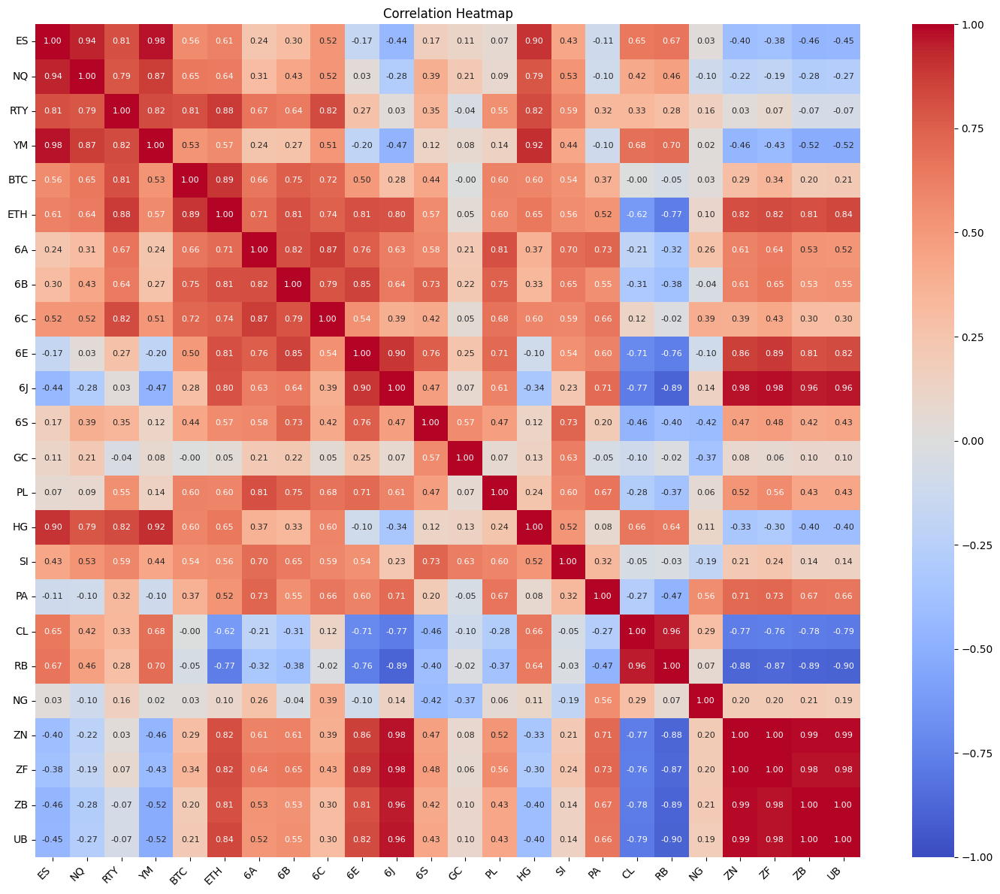

In [ ]:
#corr = correlation_matrix(df)
#print(corr)
plot_correlation_heatmap(df)

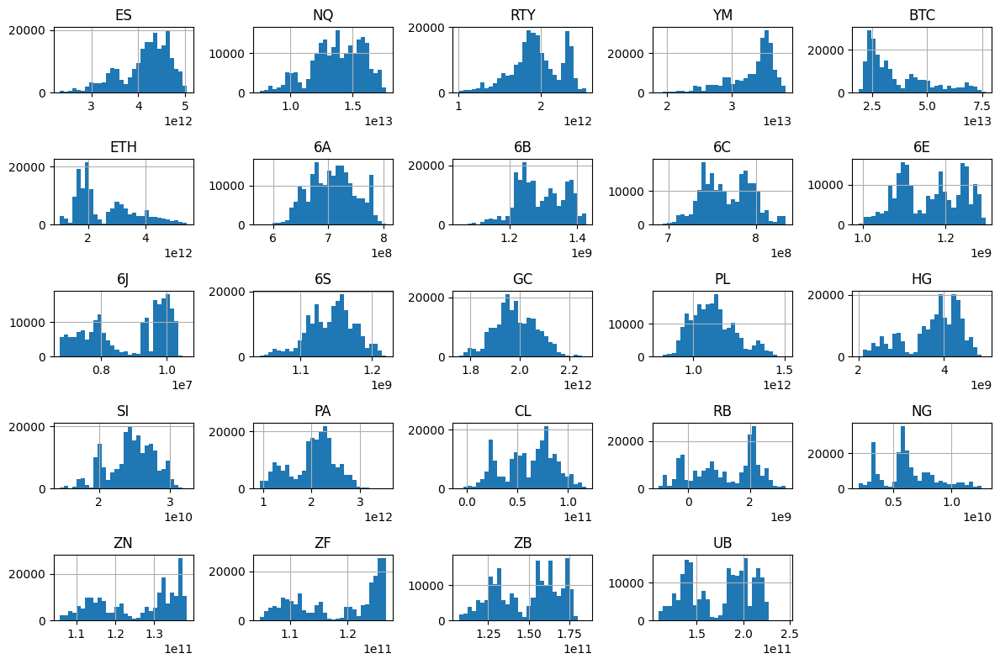

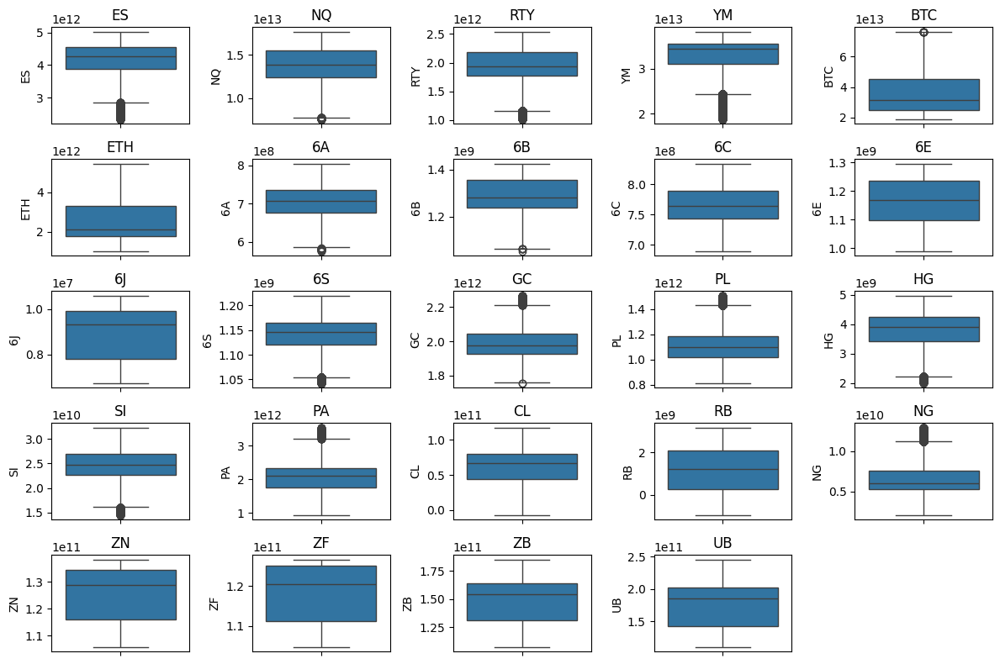

In [ ]:
plot_histograms(df)
plot_boxplots(df)
outliers = detect_outliers_iqr(df)
#print("Outliers detected:", outliers)

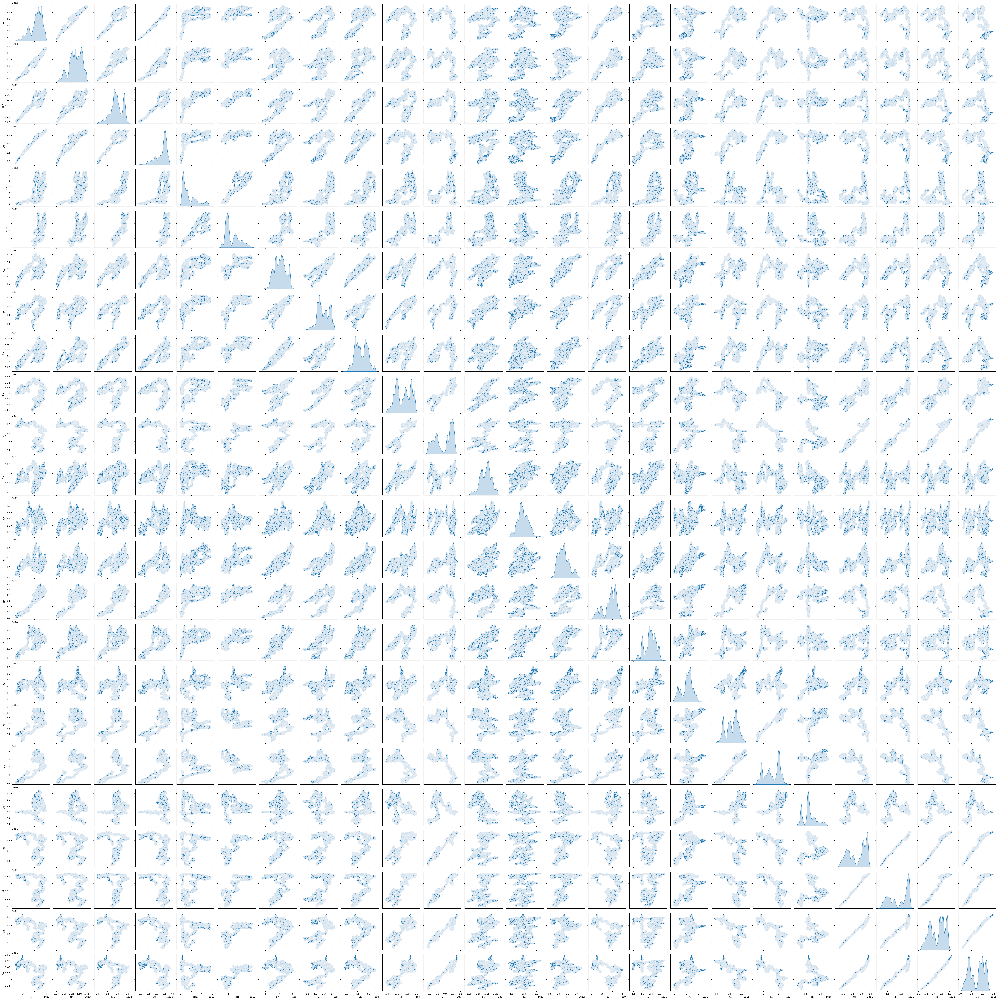

In [ ]:
plot_pairwise_relationships(df)

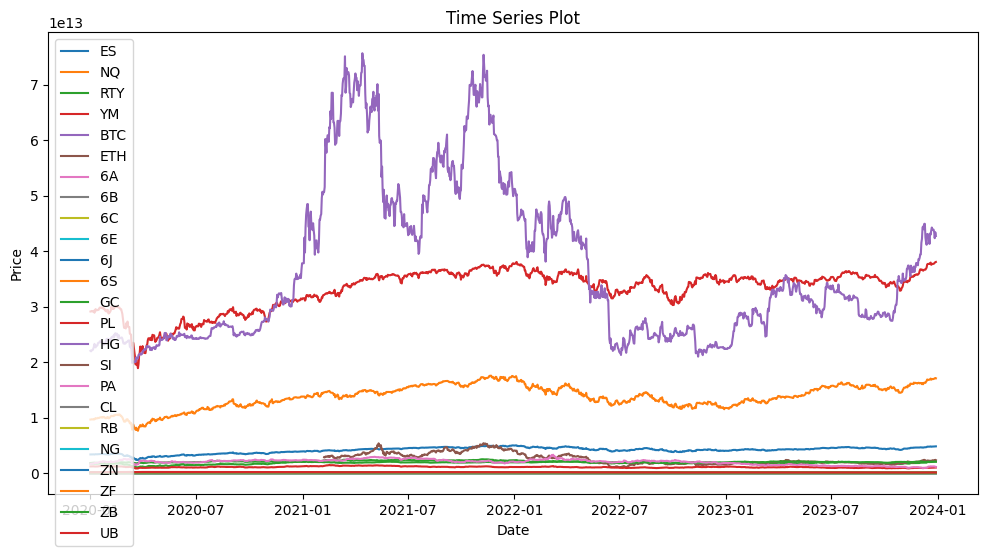

In [ ]:
plot_time_series_multiple(df.resample('1D').first()) #downsampling for faster plotting

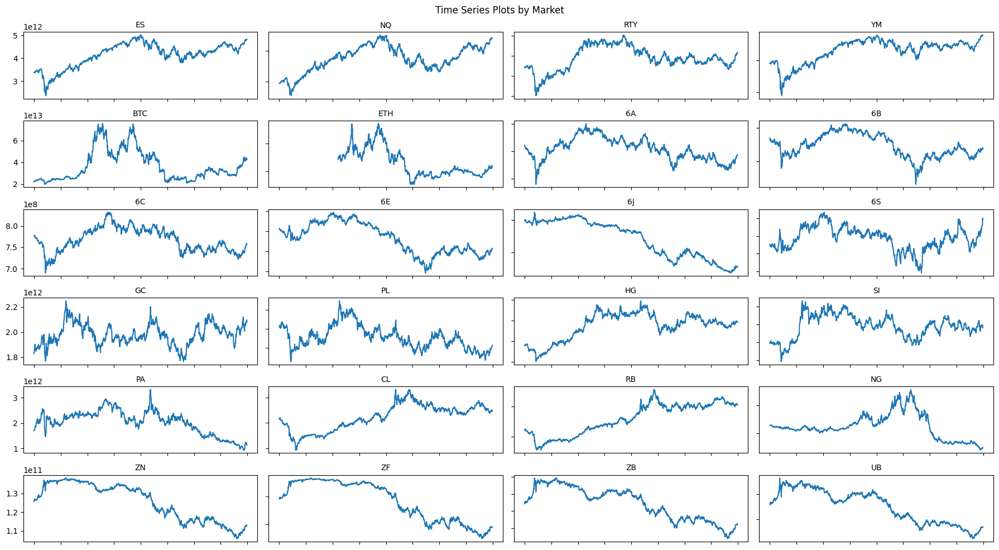

In [ ]:
plot_time_series_subplots(df.resample('1D').first(), ncols=4, figsize=(18, 10))

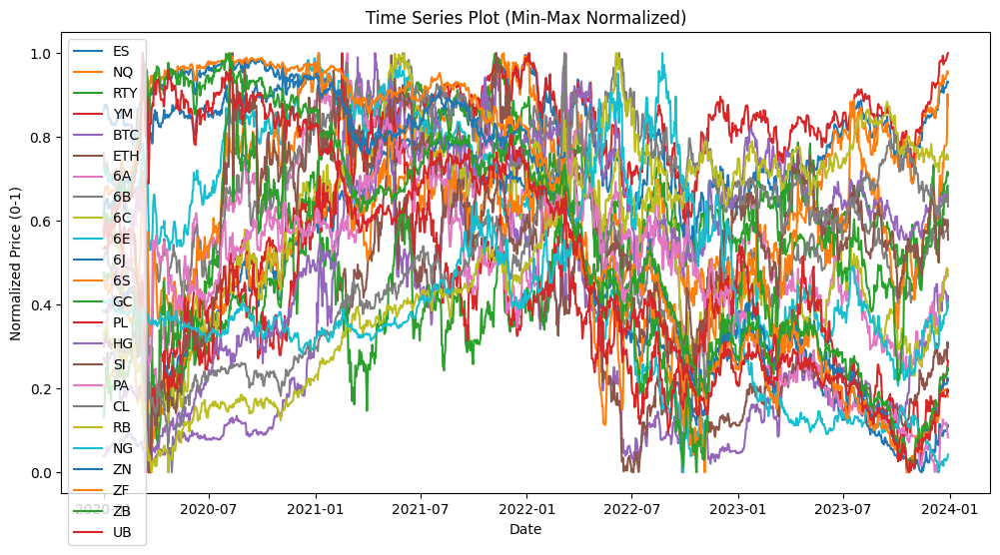

In [ ]:
plot_time_series_multiple_normalized(df.resample('1D').first())

In [ ]:
# If we are low in memory we might want to get rid of the original loaded_df and df_dict and garbage collect
import gc
#del df_loaded, df_dict
gc.collect()

0

In [ ]:
# Here is a plot of the price of ES
# (plotting too many points is slow on colab so downsample further for plotting)
#df[['ES']].resample('1D').first().plot()

## 2.3. Using returns instead of prices

In [35]:
def compute_log_return_feature(df, window=None):
    """
    Compute log return features from a price DataFrame.

    By default, if window is None, the feature is computed as:
        log( p_t / p_{t-1} )
    which is the standard log return.

    If a window is provided, then for each time t the function computes the
    average of past prices over that window (excluding the current observation)
    and calculates:
        log( p_t / <p_t>_window )
    For example, if window='3h' (and the DataFrame has a datetime index), then
    the feature becomes: log( p_t / (average price over the past 3 hours) ).

    Parameters:
      df (pd.DataFrame): A DataFrame of prices. Each column represents a price series.
      window (None, int, or str):
         - If None, uses df.shift(1) (the previous price) as the denominator.
         - If an integer, the window size in rows.
         - If a string (e.g., '3h'), the window size in time (requires a datetime index).

    Returns:
      pd.DataFrame: A DataFrame with the computed log return features, with infinite
      values replaced by NaN and then filled with 0.0.
    """
    if window is None:
        # Default: standard log returns using the previous price
        features = np.log(df / df.shift(1))
    else:
        # Compute the lagged rolling average over the specified window.
        # We use shift(1) so that the current price p_t is not included in the average.
        lagged_avg = df.shift(1).rolling(window=window).mean()
        features = np.log(df / lagged_avg)

    # Replace any infinite values with NaN and then fill NaNs with 0.0
    features = features.replace([np.inf, -np.inf], np.nan).fillna(0.0)
    return features

In [36]:
# Example usage:
# Assuming `df` is your DataFrame of prices with a datetime index.
# Standard log returns (using previous observation):
features_df_default = compute_log_return_feature(df)

# Log return relative to the average over the past x hours:
features_df_3h = compute_log_return_feature(df, window='3h')
features_df_5h = compute_log_return_feature(df, window='5h')
features_df_10h = compute_log_return_feature(df, window='10h')

# If your data is uniformly spaced and you want to use, say, 18 rows as the window:
features_df_18rows = compute_log_return_feature(df, window=18)

/usr/local/lib/python3.11/dist-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/usr/local/lib/python3.11/dist-packages/pandas/core/internals/blocks.py:393: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


# 3. Model Training

## 3.1. Ridge Regressor

### 3.1.1. Ridge Regressor, Loss Function = OLS, Features (1) = default log return

In this sub-sub-section, we are gonna train a first model using only 'features_df_default', that is standard log returns $log(P_t / P_{t-1})$

In [ ]:
features_df = features_df_default.copy()
print (features_df.shape)

(209940, 24)


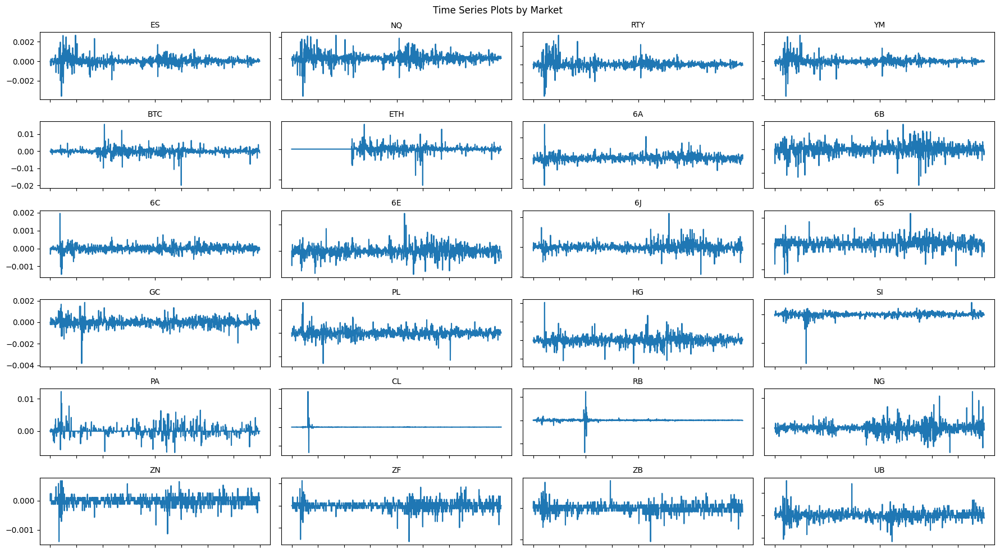

In [ ]:
plot_time_series_subplots(features_df.resample('1D').first(), ncols=4, figsize=(18, 10))

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
from scipy.stats import pearsonr
from sklearn.linear_model import Ridge

# Define parameters
n_lookback = 42
n_f = 18
n_s = 6

train_size = int(0.6 * df.shape[0])

# Split into train and test
train_features = features_df.iloc[:train_size]
test_features = features_df.iloc[train_size:]

# Initialize an empty DataFrame for predictions
prediction_df = pd.DataFrame(index=features_df.index, columns=features_df.columns)

# Dictionary to store plotting data for each instrument
# We will store: {target_col: (time_index, y_full, predictions, train_end_idx)}
results_dict = {}

for target_col in features_df.columns:
    print(f"Processing {target_col}...")

    # Build the training feature/target
    X_train, y_train = [], []
    for i in range(n_lookback, train_size - n_f):
        X_train.append(train_features.iloc[i - n_lookback:i].values.flatten())
        y_train.append(train_features[target_col].iloc[i+n_s:i + n_f].sum())

    X_train, y_train = np.array(X_train), np.array(y_train)
    if len(X_train) == 0:
        continue  # Not enough data for this instrument

    # Train a simple Ridge model
    model = Ridge(alpha=1e-6)
    model.fit(X_train, y_train) #X_train -> (125904, 1008), y_train ->(125904,)

    # Build the full feature matrix for all rows
    num_features = features_df.shape[1]
    X_full = np.array([
        features_df.iloc[i - n_lookback:i].values.flatten()
        if i >= n_lookback else np.full((n_lookback * num_features,), np.nan)
        for i in range(len(features_df))
    ])

    # Build the full target array
    y_full = np.array([
        features_df[target_col].iloc[i+n_s:i + n_f].sum()
        if i + n_f < len(features_df) else np.nan
        for i in range(n_lookback, len(features_df))
    ])

    # Generate predictions (only valid from n_lookback onward)
    predictions = model.predict(X_full[n_lookback:])

    # Evaluate correlation
    # The training portion in y_full/predictions is up to len(y_train)
    train_end_idx = len(y_train)
    corr_in = pearsonr(y_full[:train_end_idx], predictions[:train_end_idx])[0]
    # For out-of-sample, we exclude the last n_f points, or use the portion after train_end_idx
    corr_out = pearsonr(y_full[train_end_idx:-n_f], predictions[train_end_idx:-n_f])[0]
    print("Correlation in-sample/out-of-sample with target: %.2f/%.2f" % (100*corr_in, 100*corr_out))

    # Store predictions in DataFrame
    prediction_df.loc[features_df.index[n_lookback:], target_col] = predictions

    # Store and prepare data for plotting
    time_index = features_df.index[n_lookback:]  # aligned with y_full/predictions
    results_dict[target_col] = (time_index, y_full, predictions, train_end_idx, corr_in, corr_out)

# You still have your prediction_df if you want it
train_predictions = prediction_df.iloc[:train_size]
test_predictions = prediction_df.iloc[train_size:]

predictions_dict = {
    'train_predictions': train_predictions,
    'test_predictions': test_predictions
}

Processing ES...
Correlation in-sample/out-of-sample with target: 19.45/3.21
Processing NQ...
Correlation in-sample/out-of-sample with target: 17.35/2.66
Processing RTY...
Correlation in-sample/out-of-sample with target: 17.94/2.58
Processing YM...
Correlation in-sample/out-of-sample with target: 19.79/3.83
Processing BTC...
Correlation in-sample/out-of-sample with target: 10.50/1.44
Processing ETH...
Correlation in-sample/out-of-sample with target: 10.91/0.76
Processing 6A...
Correlation in-sample/out-of-sample with target: 16.07/0.58
Processing 6B...
Correlation in-sample/out-of-sample with target: 13.81/-0.55
Processing 6C...
Correlation in-sample/out-of-sample with target: 14.47/0.99
Processing 6E...
Correlation in-sample/out-of-sample with target: 13.60/1.11
Processing 6J...
Correlation in-sample/out-of-sample with target: 14.64/-0.87
Processing 6S...
Correlation in-sample/out-of-sample with target: 11.89/0.48
Processing GC...
Correlation in-sample/out-of-sample with target: 14.54

In [ ]:
import os
import pickle

# Define the base folder and filenames
SAVE_DIR = '/content/drive/MyDrive/Z_Research/logs'
os.makedirs(SAVE_DIR, exist_ok=True)

RESULTS_FILENAME = 'results_dict_ridge_ols_defaultLogReturns.pkl'
PREDICTIONS_FILENAME = 'predictions_dict_ridge_ols_defaultLogReturns.pkl'

def save_results(results_dict, predictions_dict, save_dir=SAVE_DIR,
                 results_filename=RESULTS_FILENAME, predictions_filename=PREDICTIONS_FILENAME):
    """Save the results and predictions dictionaries to files."""
    results_path = os.path.join(save_dir, results_filename)
    predictions_path = os.path.join(save_dir, predictions_filename)

    with open(results_path, 'wb') as f:
        pickle.dump(results_dict, f)
    with open(predictions_path, 'wb') as f:
        pickle.dump(predictions_dict, f)
    print("Saved results to:")
    print("  ", results_path)
    print("  ", predictions_path)

def load_results(save_dir=SAVE_DIR,
                 results_filename=RESULTS_FILENAME, predictions_filename=PREDICTIONS_FILENAME):
    """Load and return the results and predictions dictionaries from files."""
    results_path = os.path.join(save_dir, results_filename)
    predictions_path = os.path.join(save_dir, predictions_filename)

    with open(results_path, 'rb') as f:
        results_dict = pickle.load(f)
    with open(predictions_path, 'rb') as f:
        predictions_dict = pickle.load(f)
    print("Loaded results from:")
    print("  ", results_path)
    print("  ", predictions_path)
    return results_dict, predictions_dict

# Save dictionaries (run this cell after training)
save_results(results_dict, predictions_dict)

Saved results to:
   /content/drive/MyDrive/Z_Research/logs/results_dict_ridge_ols_defaultLogReturns.pkl
   /content/drive/MyDrive/Z_Research/logs/predictions_dict_ridge_ols_defaultLogReturns.pkl


In [ ]:
# Set this flag to True if you want to load the pre-saved dictionaries
load_results_flag = True

if load_results_flag:
    results_dict, predictions_dict = load_results()

Loaded results from:
   /content/drive/MyDrive/Z_Research/logs/results_dict_ridge_ols_defaultLogReturns.pkl
   /content/drive/MyDrive/Z_Research/logs/predictions_dict_ridge_ols_defaultLogReturns.pkl


In [ ]:
def plot_all_time_series(results_dict, ncols=4, figsize=(20, 12)):
    """
    Plot a grid of time-series subplots (Actual vs. Predicted), separating train vs. test predictions,
    adding a vertical line to indicate the train/test split, and including correlation info in the title.

    Parameters:
      results_dict (dict): Maps target_col -> (time_index, y_full, y_pred, train_end_idx, corr_in, corr_out).
      ncols (int): Number of columns in the grid.
      figsize (tuple): Overall figure size.
    """
    import math
    instruments = list(results_dict.keys())
    nrows = math.ceil(len(instruments) / ncols)

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharex=False, sharey=False)
    # Flatten axes array for ease of iteration:
    if isinstance(axes, (np.ndarray, list)):
        axes = axes.flatten()
    else:
        axes = [axes]

    for i, target_col in enumerate(instruments):
        ax = axes[i]
        time_index, y_full, y_pred, train_end_idx, corr_in, corr_out = results_dict[target_col]

        # Plot actual cumulative returns:
        ax.plot(time_index, y_full, color='black', label="Actual", lw=2)
        # Plot predicted values:
        ax.plot(time_index[:train_end_idx], y_pred[:train_end_idx], color='blue', linestyle='--', lw=2, label="Pred (Train)")
        ax.plot(time_index[train_end_idx:], y_pred[train_end_idx:], color='orange', linestyle='--', lw=2, label="Pred (Test)")
        # Vertical line to mark the train/test boundary:
        if 0 < train_end_idx < len(time_index):
            ax.axvline(time_index[train_end_idx], color='red', linestyle=':', lw=2)
        # Set title with correlation info:
        ax.set_title(f"{target_col}\nTrain Corr: {100*corr_in:.2f}% | Test Corr: {100*corr_out:.2f}%", fontsize=10)
        ax.set_xlabel("Time")
        ax.set_ylabel("Cumulative Return")
        ax.legend(fontsize=8)
        # Rotate x-axis tick labels:
        for tick in ax.get_xticklabels():
            tick.set_rotation(45)
            tick.set_ha("right")

    # Remove any unused subplots
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle("Time-Series Plots (Actual vs. Predicted, Train vs. Test)", fontsize=16)
    plt.tight_layout()
    plt.show()

In [ ]:
def plot_all_scatters(results_dict, ncols=4, figsize=(20, 12)):
    """
    Plot a grid of scatter subplots (Predicted vs. Actual) with separate colors for train and test points,
    including a 45° reference line and correlation info in the title.

    Parameters:
      results_dict (dict): Maps target_col -> (time_index, y_full, y_pred, train_end_idx, corr_in, corr_out).
      ncols (int): Number of columns in the grid.
      figsize (tuple): Overall figure size.
    """
    import math
    instruments = list(results_dict.keys())
    nrows = math.ceil(len(instruments) / ncols)

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharex=False, sharey=False)
    if isinstance(axes, (np.ndarray, list)):
        axes = axes.flatten()
    else:
        axes = [axes]

    for i, target_col in enumerate(instruments):
        ax = axes[i]
        _, y_full, y_pred, train_end_idx, corr_in, corr_out = results_dict[target_col]

        # Split train vs. test points:
        y_train_actual = y_full[:train_end_idx]
        y_train_pred = y_pred[:train_end_idx]
        y_test_actual = y_full[train_end_idx:]
        y_test_pred = y_pred[train_end_idx:]

        ax.scatter(y_train_actual, y_train_pred, alpha=0.6, color='blue', label='Train')
        ax.scatter(y_test_actual, y_test_pred, alpha=0.6, color='orange', label='Test')

        # 45° reference line:
        combined_vals = np.concatenate([y_full, y_pred])
        min_val = np.nanmin(combined_vals)
        max_val = np.nanmax(combined_vals)
        ax.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2)

        ax.set_xlabel("Actual Cumulative Return")
        ax.set_ylabel("Predicted Cumulative Return")
        ax.set_title(f"{target_col}\nTrain Corr: {100*corr_in:.2f}% | Test Corr: {100*corr_out:.2f}%", fontsize=10)
        ax.legend(fontsize=8)

    # Remove unused subplots if any:
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle("Scatter Plots (Actual vs. Predicted, Train vs. Test)", fontsize=16)
    plt.tight_layout()
    plt.show()

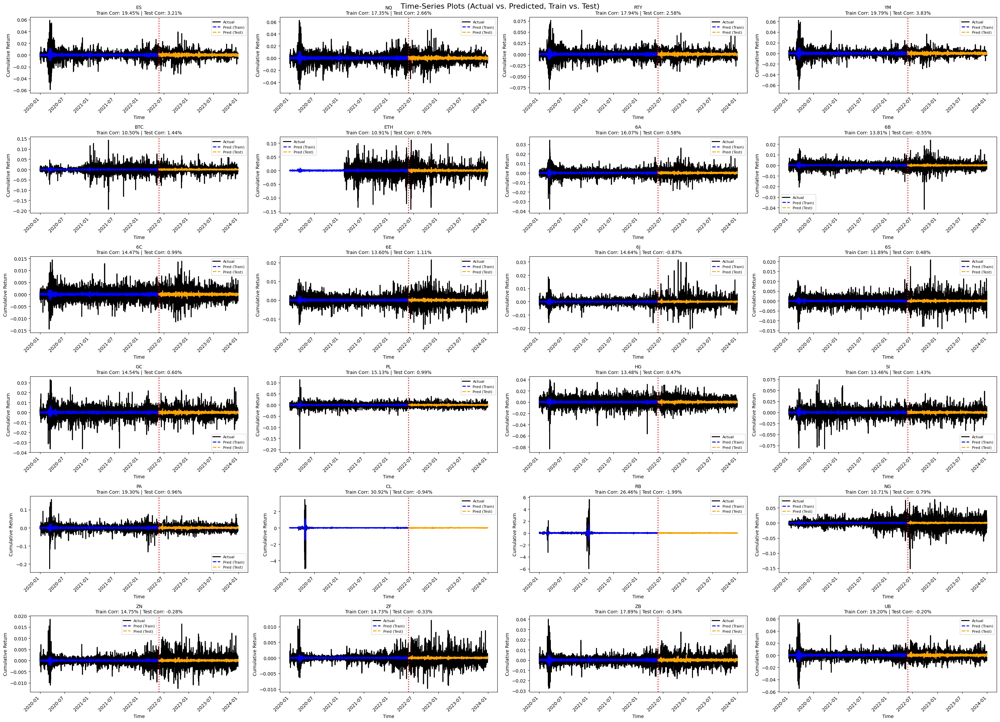

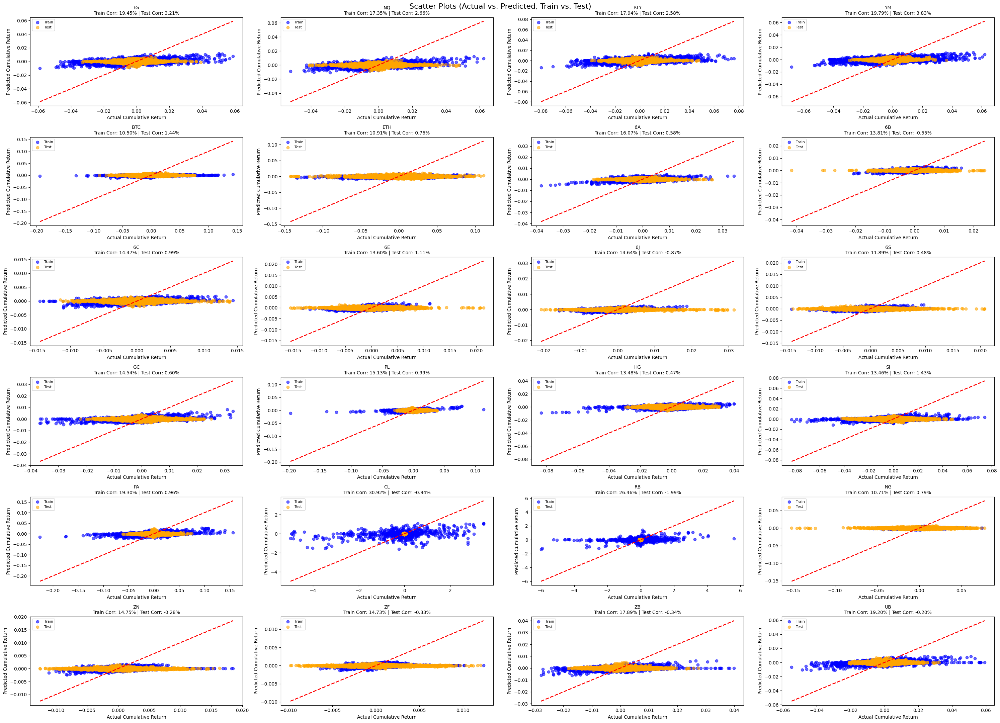

In [ ]:
# Plot time series
plot_all_time_series(results_dict, ncols=4, figsize=(30, 22))
# Plot scatter plots
plot_all_scatters(results_dict, ncols=4, figsize=(30, 22))

In [ ]:
def compute_Sharpe(market, price_df, signal_df, plot=False):
    # Compute daily returns
    returns = price_df[market].diff().shift().between_time('6:30', '16:30').dropna()
    signal = signal_df[market].ewm(halflife=24).mean().dropna()
    signal = signal.reindex(returns.index, method='ffill')

    # Compute daily PnL
    pnl = returns * signal

    daily_pnl = pnl.groupby(pnl.index.date).sum()

    if plot:
        daily_pnl.cumsum().plot()

    # Compute Sharpe ratio
    sharpe = np.sqrt(252) * daily_pnl.mean() / daily_pnl.std()
    return sharpe

In [ ]:
train_df = df[:train_size]
test_df = df[train_size:]

In [ ]:
train_sharpe ={}
test_sharpe ={}

for market in df.columns:
    train_sharpe[market] =  compute_Sharpe(market, train_df, train_predictions)
    test_sharpe[market] =  compute_Sharpe(market, test_df, test_predictions)

In [ ]:
pd.DataFrame({'Train Sharpe': train_sharpe, 'Test Sharpe': test_sharpe})

,Train Sharpe,Test Sharpe
ES,1.864288,1.504873
NQ,1.885874,0.966356
RTY,2.160661,1.707175
YM,1.662608,1.832930
BTC,2.466106,0.410705
ETH,3.006687,0.520775
6A,1.567430,1.404306
6B,1.126860,-0.664410
6C,1.835245,0.205938
6E,1.550136,-0.939211


np.float64(1.832929688920326)

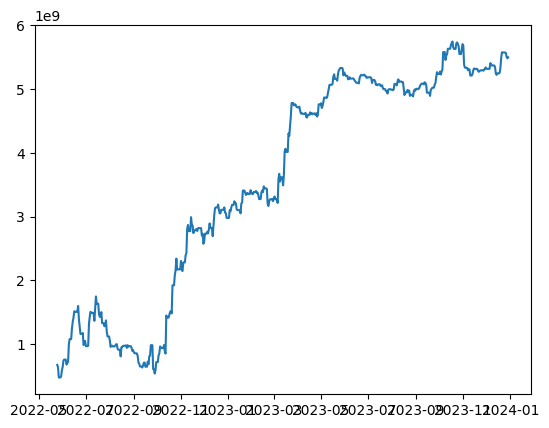

In [ ]:
compute_Sharpe('YM', test_df, test_predictions, plot=True)

# 3. Model Training (New, Generalising)

## 3.1. Ridge Regressor

### 3.1.1. Ridge Regressor, Loss Function = OLS, Features (1) = default log return

In this sub-sub-section, we are gonna train a first model using only 'features_df_default', that is standard log returns $log(P_t / P_{t-1})$

In [ ]:
features_df = features_df_default.copy()
print (features_df.shape)

(209940, 24)


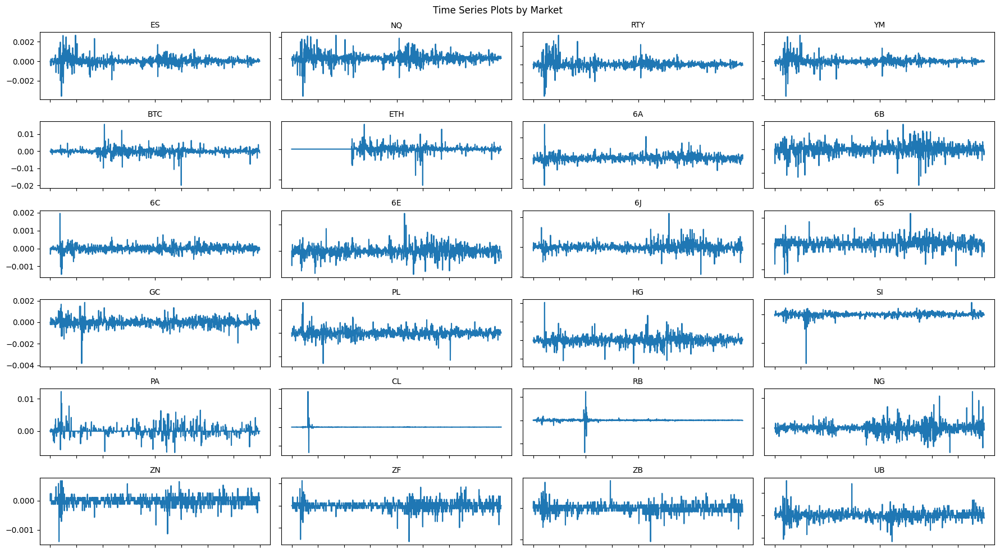

In [ ]:
plot_time_series_subplots(features_df.resample('1D').first(), ncols=4, figsize=(18, 10))

In [43]:
from tqdm import tqdm
from joblib import Parallel, delayed
from contextlib import contextmanager

@contextmanager
def tqdm_joblib(tqdm_object):
    """
    Context manager to patch joblib to report progress to tqdm.

    This patches joblib.parallel.BatchCompletionCallBack so that each completed batch
    updates the given tqdm progress bar.
    """
    # Save the original BatchCompletionCallBack
    from joblib.parallel import BatchCompletionCallBack
    old_callback = BatchCompletionCallBack

    # Define a new callback class that updates the tqdm bar
    class TqdmBatchCompletionCallBack(BatchCompletionCallBack):
        def __call__(self, *args, **kwargs):
            tqdm_object.update(n=self.batch_size)
            return super(TqdmBatchCompletionCallBack, self).__call__(*args, **kwargs)

    # Patch the joblib parallel callback
    from joblib import parallel
    parallel.BatchCompletionCallBack = TqdmBatchCompletionCallBack
    try:
        yield tqdm_object
    finally:
        # Restore the original callback and close the progress bar
        parallel.BatchCompletionCallBack = old_callback
        tqdm_object.close()


In [75]:
def plot_all_time_series(results_dict, ncols=4, figsize=(20, 12), hyperparameter_validation=False):
    """
    Plot a grid of time-series subplots (Actual vs. Predicted), separating train vs. test/validation predictions,
    adding a vertical line to indicate the train/test or train/val split, and including correlation info in the title.

    Parameters:
      results_dict (dict): Maps target_col -> (time_index, y_full, y_pred, train_end_idx, corr_train, corr_val_or_test)
      ncols (int): Number of columns in the grid.
      figsize (tuple): Overall figure size.
      hyperparameter_validation (bool): If True, treat the 6th element as validation correlation and update labels.
    """
    import math
    instruments = list(results_dict.keys())
    nrows = math.ceil(len(instruments) / ncols)

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharex=False, sharey=False)
    # Flatten axes array for ease of iteration:
    if isinstance(axes, (list, np.ndarray)):
        axes = axes.flatten()
    else:
        axes = [axes]

    for i, target_col in enumerate(instruments):
        ax = axes[i]
        time_index, y_full, y_pred, train_end_idx, corr_train, corr_other = results_dict[target_col]

        # Plot actual cumulative returns:
        ax.plot(time_index, y_full, color='black', label="Actual", lw=2)
        # Plot predicted values:
        if hyperparameter_validation:
            ax.plot(time_index[:train_end_idx], y_pred[:train_end_idx], color='blue', linestyle='--', lw=2, label="Pred (Train)")
            ax.plot(time_index[train_end_idx:], y_pred[train_end_idx:], color='orange', linestyle='--', lw=2, label="Pred (Val)")
            title_str = f"{target_col}\nTrain Corr: {100*corr_train:.2f}% | Val Corr: {100*corr_other:.2f}%"
        else:
            ax.plot(time_index[:train_end_idx], y_pred[:train_end_idx], color='blue', linestyle='--', lw=2, label="Pred (Train)")
            ax.plot(time_index[train_end_idx:], y_pred[train_end_idx:], color='orange', linestyle='--', lw=2, label="Pred (Test)")
            title_str = f"{target_col}\nTrain Corr: {100*corr_train:.2f}% | Test Corr: {100*corr_other:.2f}%"

        # Vertical line marking the split:
        if 0 < train_end_idx < len(time_index):
            ax.axvline(time_index[train_end_idx], color='red', linestyle=':', lw=2)
        ax.set_title(title_str, fontsize=10)
        ax.set_xlabel("Time")
        ax.set_ylabel("Cumulative Return")
        ax.legend(fontsize=8)
        # Rotate x-axis tick labels:
        for tick in ax.get_xticklabels():
            tick.set_rotation(45)
            tick.set_ha("right")

    # Remove any unused subplots
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle("Time-Series Plots (Actual vs. Predicted)", fontsize=16)
    plt.tight_layout()
    plt.show()

In [76]:
def plot_all_scatters(results_dict, ncols=4, figsize=(20, 12), hyperparameter_validation=False):
    """
    Plot a grid of scatter subplots (Predicted vs. Actual) with separate colors for train and test/validation points,
    including a 45° reference line and correlation info in the title.

    Parameters:
      results_dict (dict): Maps target_col -> (time_index, y_full, predictions, train_end_idx, corr_train, corr_val_or_test)
      ncols (int): Number of columns in the grid.
      figsize (tuple): Overall figure size.
      hyperparameter_validation (bool): If True, the second correlation is considered a validation correlation.
                                        Otherwise, it is a test correlation.
    """
    import math
    instruments = list(results_dict.keys())
    nrows = math.ceil(len(instruments) / ncols)

    fig, axes = plt.subplots(nrows, ncols, figsize=figsize, sharex=False, sharey=False)
    if isinstance(axes, (list, np.ndarray)):
        axes = axes.flatten()
    else:
        axes = [axes]

    for i, target_col in enumerate(instruments):
        ax = axes[i]
        _, y_full, y_pred, train_end_idx, corr_train, corr_other = results_dict[target_col]

        # Split train vs. test/validation points
        y_train_actual = y_full[:train_end_idx]
        y_train_pred   = y_pred[:train_end_idx]
        y_other_actual = y_full[train_end_idx:]
        y_other_pred   = y_pred[train_end_idx:]

        ax.scatter(y_train_actual, y_train_pred, alpha=0.6, color='blue', label='Train')
        if hyperparameter_validation:
            ax.scatter(y_other_actual, y_other_pred, alpha=0.6, color='orange', label='Val')
            title_str = f"{target_col}\nTrain Corr: {100*corr_train:.2f}% | Val Corr: {100*corr_other:.2f}%"
        else:
            ax.scatter(y_other_actual, y_other_pred, alpha=0.6, color='orange', label='Test')
            title_str = f"{target_col}\nTrain Corr: {100*corr_train:.2f}% | Test Corr: {100*corr_other:.2f}%"

        # 45° reference line
        combined_vals = np.concatenate([y_full, y_pred])
        min_val = np.nanmin(combined_vals)
        max_val = np.nanmax(combined_vals)
        ax.plot([min_val, max_val], [min_val, max_val], 'r--', lw=2)

        ax.set_xlabel("Actual Cumulative Return")
        ax.set_ylabel("Predicted Cumulative Return")
        ax.set_title(title_str, fontsize=10)
        ax.legend(fontsize=8)

    # Remove unused subplots if any:
    for j in range(i+1, len(axes)):
        fig.delaxes(axes[j])

    fig.suptitle("Scatter Plots (Actual vs. Predicted)", fontsize=16)
    plt.tight_layout()
    plt.show()

In [77]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import math
from scipy.stats import pearsonr
from sklearn.linear_model import Ridge
from joblib import Parallel, delayed
from tqdm import tqdm

def train_model(features_df, df, n_lookback_list, n_f_list, n_s_list, hyperparameter_validation=False, n_jobs=4):
    """
    Train a Ridge model for each target (original instrument) using a rolling-window approach.

    Hyperparameters (n_lookback, n_f, n_s) must be provided as lists.

    When hyperparameter_validation is False:
      - Each list must have exactly one element; otherwise a ValueError is raised.
      - The data is split into 60% train and 40% test.
      - For each target, a model is trained using the provided hyperparameters,
        and predictions are made on the full data (from n_lookback onward).
      - The function returns:
          results_dict[target_col] = (time_index, y_full, predictions, train_end_idx, corr_train, corr_test)
          predictions_dict contains train and test predictions.

    When hyperparameter_validation is True:
      - The overall data is split into 60% train and 40% test (same as original).
      - However, within the 60% train portion, 20% is reserved for validation and 80% for training.
        That is, effective_train_size = 80% of 60% (i.e. 48% overall) and validation size = 20% of 60% (i.e. 12% overall).
      - For each target, the function iterates over all candidate combinations
        (for n_lookback, n_f, n_s) and trains a model on the effective train partition.
      - It then evaluates on the validation partition (computing both train and val correlations)
        and selects the best combination for that target based solely on validation correlation.
      - For that target, the function returns:
          results_dict[target_col] = (time_index_val, y_val, predictions_val, train_end_idx, corr_train, corr_val)
      - predictions_dict is built with placeholders (e.g., val_predictions, test_predictions).

    Note:
      - When hyperparameter_validation is True, hyperparameters are validated per target, so
        the model for ES might use different values than the model for NQ.
      - When hyperparameter_validation is False, each hyperparameter list must have one element.

    Returns:
      results_dict (dict): Maps target_col -> (time_index, y_full, predictions, train_end_idx, corr_train, corr_val_or_test)
      predictions_dict (dict): Contains predictions for the partitions.
    """
    total = len(df)

    if hyperparameter_validation:
        # Keep overall train/test split as before: 60% train, 40% test.
        train_test_split = int(0.6 * total)
        test_size  = total - train_test_split
        # Within the train partition, reserve 20% for validation and 80% for training.
        val_size = int(0.2 * train_test_split)            # 20% of train partition
        effective_train_size = train_test_split - val_size  # 80% of train partition

        # For model training, use only the effective training subset.
        train_features = features_df.iloc[:effective_train_size]
        # The validation set will be taken from indices [effective_train_size, train_test_split)
        # The test set remains as features_df.iloc[train_test_split:]
    else:
        if len(n_lookback_list) != 1 or len(n_f_list) != 1 or len(n_s_list) != 1:
            raise ValueError("When hyperparameter_validation is False, each hyperparameter list must have exactly one element.")
        n_lookback = n_lookback_list[0]
        n_f = n_f_list[0]
        n_s = n_s_list[0]
        train_test_split = int(0.6 * total)
        train_features = features_df.iloc[:train_test_split]
        test_features  = features_df.iloc[train_test_split:]

    results_dict = {}
    prediction_df = pd.DataFrame(index=features_df.index, columns=features_df.columns)

    # ---------------------------------------------------------
    # 1) Inner function that trains a model for a single target
    #    and returns both results and a list of log messages.
    # ---------------------------------------------------------
    def train_for_target(target_col, n_jobs):
        log_messages = []
        if hyperparameter_validation:
            best_corr_val = -np.inf
            best_params = None
            best_local_results = None

            # Iterate over candidate hyperparameter combinations (per target)
            for lb in n_lookback_list:
                for nf in n_f_list:
                    for ns in n_s_list:
                        # Build training set from indices: [lb, effective_train_size - nf)
                        X_train, y_train = [], []
                        for i in range(lb, effective_train_size - nf):
                            X_train.append(train_features.iloc[i - lb:i].values.flatten())
                            y_train.append(train_features[target_col].iloc[i+ns:i+nf].sum())
                        X_train, y_train = np.array(X_train), np.array(y_train)
                        if len(X_train) == 0:
                            continue

                        model = Ridge(alpha=1e-6)
                        model.fit(X_train, y_train)

                        # Training correlation
                        predictions_train = model.predict(X_train)
                        corr_train = pearsonr(y_train, predictions_train)[0]

                        # Build validation set from indices: [effective_train_size, train_test_split)
                        X_val, y_val = [], []
                        for i in range(effective_train_size, train_test_split):
                            X_val.append(features_df.iloc[i - lb:i].values.flatten())
                            if i + nf < len(features_df):
                                y_val.append(features_df[target_col].iloc[i+ns:i+nf].sum())
                            else:
                                y_val.append(np.nan)
                        X_val, y_val = np.array(X_val), np.array(y_val)
                        predictions_val = model.predict(X_val)
                        valid_mask = ~np.isnan(y_val)
                        corr_val = pearsonr(y_val[valid_mask], predictions_val[valid_mask])[0] if valid_mask.sum() > 0 else -np.inf

                        # Build test set from indices: [train_test_split, total)
                        X_test, y_test = [], []
                        for i in range(train_test_split, total):
                            X_test.append(features_df.iloc[i - lb:i].values.flatten())
                            if i + nf < len(features_df):
                                y_test.append(features_df[target_col].iloc[i+ns:i+nf].sum())
                            else:
                                y_test.append(np.nan)
                        X_test, y_test = np.array(X_test), np.array(y_test)
                        predictions_test = model.predict(X_test)
                        test_mask = ~np.isnan(y_test)
                        corr_test = pearsonr(y_test[test_mask], predictions_test[test_mask])[0] if test_mask.sum() > 0 else -np.inf

                        msg = (f"   {target_col}: lb={lb}, nf={nf}, ns={ns} -> "
                              f"Train corr: {100*corr_train:.2f}%, Val corr: {100*corr_val:.2f}%, Test corr: {100*corr_test:.2f}%")
                        log_messages.append(msg)

                        if corr_val > best_corr_val:
                            best_corr_val = corr_val
                            best_params = (lb, nf, ns)
                            best_local_results = (features_df.index[effective_train_size:train_test_split],
                                                  np.array(y_val),
                                                  predictions_val,
                                                  len(y_train),
                                                  corr_train,
                                                  corr_val,
                                                  corr_test)
            if best_local_results is None:
                log_messages.append(f"No valid parameters for {target_col}.")
                return None, log_messages

            combined_msg = (f"{target_col}: Best hyperparameters: lb={best_params[0]}, nf={best_params[1]}, ns={best_params[2]}. "
                            f"Corr Train/Val/Test: {100*best_local_results[4]:.2f}% / "
                            f"{100*best_local_results[5]:.2f}% / {100*corr_test_best:.2f}%")

            log_messages.append(combined_msg)
            return (target_col, best_local_results), log_messages
        else:
            # Non-validation mode remains unchanged.
            lb = n_lookback_list[0]
            nf = n_f_list[0]
            ns = n_s_list[0]
            X_train, y_train = [], []
            for i in range(lb, train_test_split - nf):
                X_train.append(train_features.iloc[i - lb:i].values.flatten())
                y_train.append(train_features[target_col].iloc[i+ns:i+nf].sum())
            X_train, y_train = np.array(X_train), np.array(y_train)
            if len(X_train) == 0:
                log_messages.append(f"Not enough data for {target_col}.")
                return None, log_messages
            model = Ridge(alpha=1e-6)
            model.fit(X_train, y_train)
            num_features = features_df.shape[1]
            X_full = np.array([
                features_df.iloc[i - lb:i].values.flatten() if i >= lb else np.full((lb * num_features,), np.nan)
                for i in range(len(features_df))
            ])
            y_full = np.array([
                features_df[target_col].iloc[i+ns:i+nf].sum() if i+nf < len(features_df) else np.nan
                for i in range(lb, len(features_df))
            ])
            predictions = model.predict(X_full[lb:])
            train_end_idx = len(y_train)
            corr_train = pearsonr(y_full[:train_end_idx], predictions[:train_end_idx])[0]
            corr_test = pearsonr(y_full[train_end_idx:-nf], predictions[train_end_idx:-nf])[0]
            msg = (f"{target_col}: Corr Train/Test: {100*corr_train:.2f}% / {100*corr_test:.2f}%")
            log_messages.append(msg)
            return (target_col, (features_df.index[lb:], y_full, predictions, train_end_idx, corr_train, corr_test)), log_messages

    # ---------------------------------------------------------
    # 2) Run training for each target in parallel,
    #    wrapping the iterable with tqdm for a simple progress bar.
    # ---------------------------------------------------------
    results_list_with_logs = Parallel(n_jobs=n_jobs)(
        delayed(train_for_target)(target_col, n_jobs) for target_col in tqdm(features_df_default.columns)
    )

    # Separate the actual results from the logs
    results_list = []
    all_logs = []
    for item in results_list_with_logs:
        if item is None:
            continue
        (res, logs) = item
        if res is not None:
            results_list.append(res)
        if logs is not None:
            all_logs.append(logs)

    # Now print all logs (in the master process)
    for log_block in all_logs:
        for line in log_block:
            print(line)

    # ---------------------------------------------------------
    # 3) Build results_dict and predictions_dict
    # ---------------------------------------------------------
    results_list = [r for r in results_list if r is not None]
    results_dict = {target: res for (target, res) in results_list}

    prediction_df = pd.DataFrame(index=features_df.index, columns=features_df.columns)
    if not hyperparameter_validation:
        for target_col, (time_idx, y_full, predictions, train_end_idx, corr_train, corr_test) in results_dict.items():
            prediction_df.loc[time_idx, target_col] = predictions
        predictions_dict = {
            'train_predictions': prediction_df.iloc[:train_test_split],
            'test_predictions': prediction_df.iloc[train_test_split:]
        }
    else:
        predictions_dict = {
            'train_predictions': None,
            'val_predictions': features_df.iloc[effective_train_size:train_test_split],
            'test_predictions': features_df.iloc[train_test_split:]
        }

    return results_dict, predictions_dict

**Hyperparameter validation mode**

In [78]:
# Provide lists of candidates
n_lookback_candidates = [30, 42, 50]
n_f_candidates = [18]
n_s_candidates = [6]

results_dict, predictions_dict = train_model(features_df, df, n_lookback_candidates,
                                             n_f_candidates, n_s_candidates,
                                             hyperparameter_validation=True)





  0%|          | 0/24 [00:00<?, ?it/s]



 17%|█▋        | 4/24 [00:00<00:02,  6.85it/s]



 33%|███▎      | 8/24 [01:39<03:54, 14.64s/it]



 50%|█████     | 12/24 [03:16<03:48, 19.02s/it]



 67%|██████▋   | 16/24 [04:53<02:48, 21.02s/it]/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(




 83%|████████▎ | 20/24 [06:29<01:28, 22.16s/it]



100%|██████████| 24/24 [08:05<00:00, 20.24s/it]
/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(


   ES: lb=30, nf=18, ns=6 -> Train corr: 19.98%, Val corr: -2.11%, Test corr: 2.71%
   ES: lb=42, nf=18, ns=6 -> Train corr: 23.37%, Val corr: -0.77%, Test corr: 3.24%
   ES: lb=50, nf=18, ns=6 -> Train corr: 24.48%, Val corr: -0.40%, Test corr: 3.15%
ES: Corr Train/Val/Test: 24.48% / -0.40% / 3.15%
   NQ: lb=30, nf=18, ns=6 -> Train corr: 18.14%, Val corr: -0.48%, Test corr: 2.68%
   NQ: lb=42, nf=18, ns=6 -> Train corr: 21.07%, Val corr: 0.61%, Test corr: 3.11%
   NQ: lb=50, nf=18, ns=6 -> Train corr: 22.11%, Val corr: 1.07%, Test corr: 3.08%
NQ: Corr Train/Val/Test: 22.11% / 1.07% / 3.08%
   RTY: lb=30, nf=18, ns=6 -> Train corr: 17.96%, Val corr: -0.51%, Test corr: 1.68%
   RTY: lb=42, nf=18, ns=6 -> Train corr: 21.18%, Val corr: 0.25%, Test corr: 2.62%
   RTY: lb=50, nf=18, ns=6 -> Train corr: 22.04%, Val corr: 0.79%, Test corr: 2.53%
RTY: Corr Train/Val/Test: 22.04% / 0.79% / 2.53%
   YM: lb=30, nf=18, ns=6 -> Train corr: 19.89%, Val corr: -3.60%, Test corr: 3.40%
   YM: lb=42, n

**Non-hyperparameter validation mode**

In [79]:
# Provide single-element lists
results_dict_noHPV, predictions_dict_noHPV = train_model(features_df, df, [42], [18], [6],
                                             hyperparameter_validation=False)





  0%|          | 0/24 [00:00<?, ?it/s]



 33%|███▎      | 8/24 [00:46<01:33,  5.83s/it]/usr/local/lib/python3.11/dist-packages/joblib/externals/loky/process_executor.py:752: UserWarning: A worker stopped while some jobs were given to the executor. This can be caused by a too short worker timeout or by a memory leak.
  warnings.warn(




 50%|█████     | 12/24 [01:36<01:43,  8.65s/it]



 67%|██████▋   | 16/24 [02:22<01:17,  9.64s/it]



 83%|████████▎ | 20/24 [03:09<00:41, 10.36s/it]



100%|██████████| 24/24 [03:55<00:00,  9.83s/it]


ES: Corr Train/Test: 19.45% / 3.21%
NQ: Corr Train/Test: 17.35% / 2.66%
RTY: Corr Train/Test: 17.94% / 2.58%
YM: Corr Train/Test: 19.79% / 3.83%
BTC: Corr Train/Test: 10.50% / 1.44%
ETH: Corr Train/Test: 10.91% / 0.76%
6A: Corr Train/Test: 16.07% / 0.58%
6B: Corr Train/Test: 13.81% / -0.55%
6C: Corr Train/Test: 14.47% / 0.99%
6E: Corr Train/Test: 13.60% / 1.11%
6J: Corr Train/Test: 14.64% / -0.87%
6S: Corr Train/Test: 11.89% / 0.48%
GC: Corr Train/Test: 14.54% / 0.60%
PL: Corr Train/Test: 15.13% / 0.99%
HG: Corr Train/Test: 13.48% / 0.47%
SI: Corr Train/Test: 13.46% / 1.43%
PA: Corr Train/Test: 19.30% / 0.96%
CL: Corr Train/Test: 30.92% / -0.94%
RB: Corr Train/Test: 26.46% / -1.99%
NG: Corr Train/Test: 10.71% / 0.79%
ZN: Corr Train/Test: 14.75% / -0.28%
ZF: Corr Train/Test: 14.73% / -0.33%
ZB: Corr Train/Test: 17.89% / -0.34%
UB: Corr Train/Test: 19.20% / -0.20%


In [ ]:
import os
import pickle

# Define the base folder and filenames

SAVE_DIR = '/content/drive/MyDrive/Z_Research/logs'
os.makedirs(SAVE_DIR, exist_ok=True)

RESULTS_FILENAME = 'results_dict_ridge_ols_defaultLogReturns.pkl'
PREDICTIONS_FILENAME = 'predictions_dict_ridge_ols_defaultLogReturns.pkl'

def save_results(results_dict, predictions_dict, save_dir=SAVE_DIR,
                 results_filename=RESULTS_FILENAME, predictions_filename=PREDICTIONS_FILENAME):
    """Save the results and predictions dictionaries to files."""
    results_path = os.path.join(save_dir, results_filename)
    predictions_path = os.path.join(save_dir, predictions_filename)

    with open(results_path, 'wb') as f:
        pickle.dump(results_dict, f)
    with open(predictions_path, 'wb') as f:
        pickle.dump(predictions_dict, f)
    print("Saved results to:")
    print("  ", results_path)
    print("  ", predictions_path)

def load_results(save_dir=SAVE_DIR,
                 results_filename=RESULTS_FILENAME, predictions_filename=PREDICTIONS_FILENAME):
    """Load and return the results and predictions dictionaries from files."""
    results_path = os.path.join(save_dir, results_filename)
    predictions_path = os.path.join(save_dir, predictions_filename)

    with open(results_path, 'rb') as f:
        results_dict = pickle.load(f)
    with open(predictions_path, 'rb') as f:
        predictions_dict = pickle.load(f)
    print("Loaded results from:")
    print("  ", results_path)
    print("  ", predictions_path)
    return results_dict, predictions_dict

# Save dictionaries (run this cell after training)
save_results(results_dict, predictions_dict)

In [ ]:
def compute_Sharpe(market, price_df, signal_df, plot=False):
    # Compute daily returns
    returns = price_df[market].diff().shift().between_time('6:30', '16:30').dropna()
    signal = signal_df[market].ewm(halflife=24).mean().dropna()
    signal = signal.reindex(returns.index, method='ffill')

    # Compute daily PnL
    pnl = returns * signal

    daily_pnl = pnl.groupby(pnl.index.date).sum()

    if plot:
        daily_pnl.cumsum().plot()

    # Compute Sharpe ratio
    sharpe = np.sqrt(252) * daily_pnl.mean() / daily_pnl.std()
    return sharpe

In [ ]:
train_df = df[:train_size]
test_df = df[train_size:]

In [ ]:
train_sharpe ={}
test_sharpe ={}

for market in df.columns:
    train_sharpe[market] =  compute_Sharpe(market, train_df, train_predictions)
    test_sharpe[market] =  compute_Sharpe(market, test_df, test_predictions)

In [ ]:
pd.DataFrame({'Train Sharpe': train_sharpe, 'Test Sharpe': test_sharpe})

In [ ]:
compute_Sharpe('YM', test_df, test_predictions, plot=True)

In [ ]:
# Set this flag to True if you want to load the pre-saved dictionaries
load_results_flag = False

if load_results_flag:
    results_dict, predictions_dict = load_results()

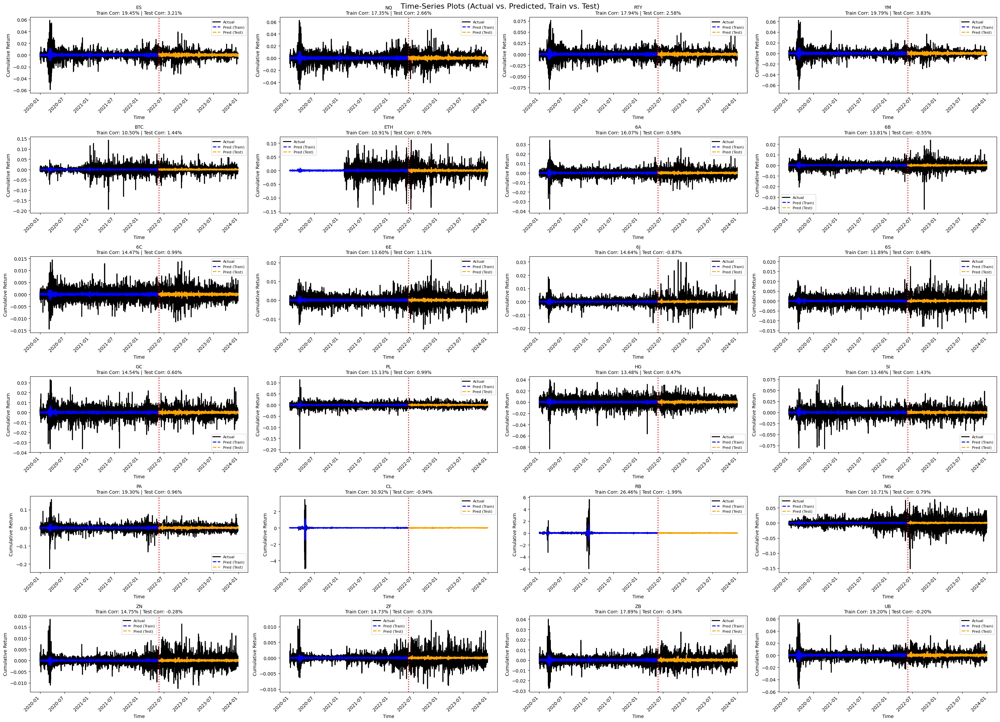

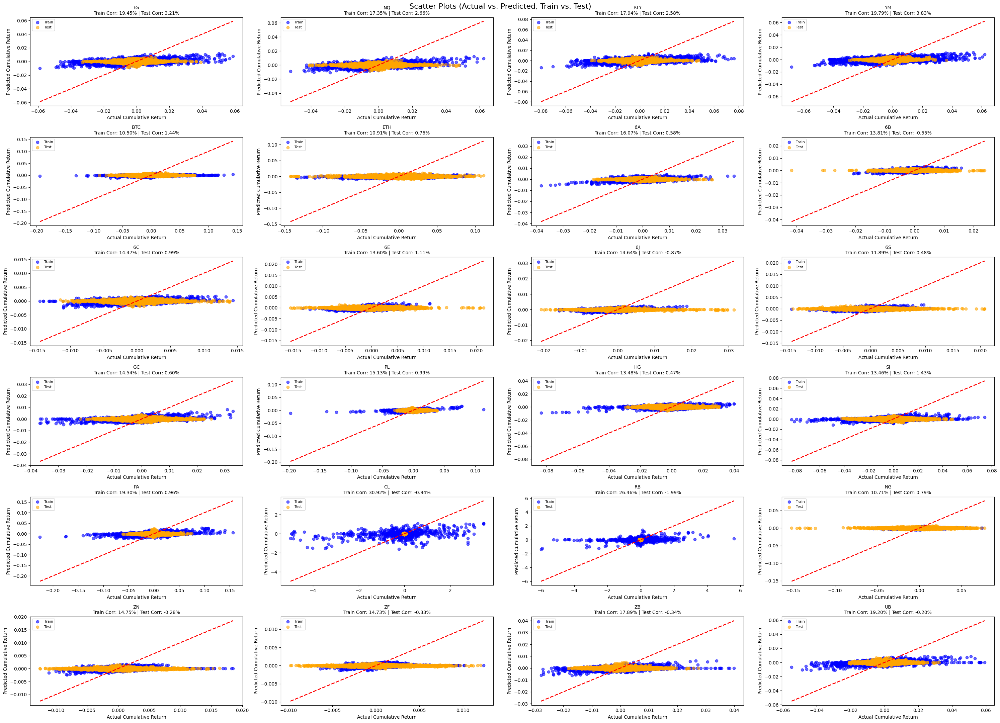

In [58]:
# Plot time series
plot_all_time_series(results_dict, ncols=4, figsize=(30, 22))
# Plot scatter plots
plot_all_scatters(results_dict, ncols=4, figsize=(30, 22))

In [ ]:
def compute_Sharpe(market, price_df, signal_df, plot=False):
    # Compute daily returns
    returns = price_df[market].diff().shift().between_time('6:30', '16:30').dropna()
    signal = signal_df[market].ewm(halflife=24).mean().dropna()
    signal = signal.reindex(returns.index, method='ffill')

    # Compute daily PnL
    pnl = returns * signal

    daily_pnl = pnl.groupby(pnl.index.date).sum()

    if plot:
        daily_pnl.cumsum().plot()

    # Compute Sharpe ratio
    sharpe = np.sqrt(252) * daily_pnl.mean() / daily_pnl.std()
    return sharpe

In [ ]:
if hyperparameter_validation:
    # Define splits consistent with your training function:
    val_df = df.iloc[effective_train_size:train_test_split]
    test_df = df.iloc[train_test_split:]

    val_sharpe = {}
    test_sharpe = {}

    for market in df.columns:
        val_sharpe[market] = compute_Sharpe(market, val_df, predictions_dict['val_predictions'])
        test_sharpe[market] = compute_Sharpe(market, test_df, predictions_dict['test_predictions'])

    sharpe_df = pd.DataFrame({'Validation Sharpe': val_sharpe, 'Test Sharpe': test_sharpe})
    display(sharpe_df)
else:
    train_df = df.iloc[:train_test_split]
    test_df = df.iloc[train_test_split:]

    train_sharpe = {}
    test_sharpe = {}

    for market in df.columns:
        train_sharpe[market] = compute_Sharpe(market, train_df, predictions_dict['train_predictions'])
        test_sharpe[market] = compute_Sharpe(market, test_df, predictions_dict['test_predictions'])

    sharpe_df = pd.DataFrame({'Train Sharpe': train_sharpe, 'Test Sharpe': test_sharpe})
    display(sharpe_df)

In [ ]:
train_df = df[:train_size]
test_df = df[train_size:]

In [ ]:
train_sharpe ={}
test_sharpe ={}

for market in df.columns:
    train_sharpe[market] =  compute_Sharpe(market, train_df, train_predictions)
    test_sharpe[market] =  compute_Sharpe(market, test_df, test_predictions)

In [ ]:
pd.DataFrame({'Train Sharpe': train_sharpe, 'Test Sharpe': test_sharpe})

,Train Sharpe,Test Sharpe
ES,1.864288,1.504873
NQ,1.885874,0.966356
RTY,2.160661,1.707175
YM,1.662608,1.832930
BTC,2.466106,0.410705
ETH,3.006687,0.520775
6A,1.567430,1.404306
6B,1.126860,-0.664410
6C,1.835245,0.205938
6E,1.550136,-0.939211


np.float64(1.832929688920326)

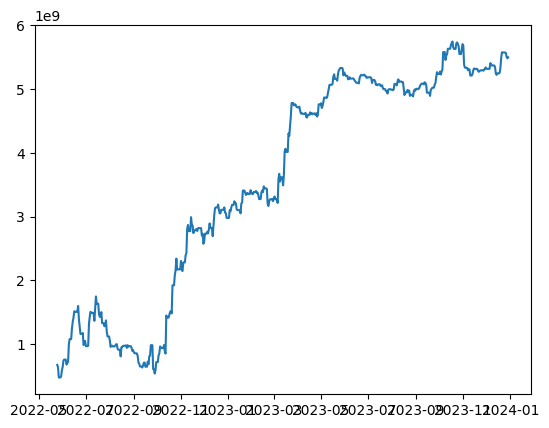

In [ ]:
compute_Sharpe('YM', test_df, test_predictions, plot=True)